# Recipes and Ratings Final Project

**Name(s)**: Kevin Chen, Parna Praveen

**Website Link**: https://parnapraveen.github.io/RecipeProject/

In [153]:
import pandas as pd
import numpy as np
from pathlib import Path

import plotly.express as px
pd.options.plotting.backend = 'plotly'
# from dsc80_utils import * # Feel free to uncomment and use this.

## Step 1: Introduction

In [155]:
# TODO
fp1 = "./food_data/RAW_recipes.csv"#Path('food_data') / 'RAW_recipes.csv'
recipes = pd.read_csv(fp1)
fp2 = "./food_data/RAW_interactions.csv"#Path('food_data') / 'RAW_interactions.csv'
interactions = pd.read_csv(fp2)

In [156]:
interactions.head(5)

,user_id,recipe_id,date,rating,review
0,1293707,40893,2011-12-21,5,"So simple, so delicious! Great for chilly fall..."
1,126440,85009,2010-02-27,5,I made the Mexican topping and took it to bunk...
2,57222,85009,2011-10-01,5,"Made the cheddar bacon topping, adding a sprin..."
3,124416,120345,2011-08-06,0,"Just an observation, so I will not rate. I fo..."
4,2000192946,120345,2015-05-10,2,This recipe was OVERLY too sweet. I would sta...


Fixed the recipes column by extracting data in "nutrition" column and giving each value its corresponding column. Here, we created individual columns in our dataset called 'calories', 'total_fat', 'sugar', 'sodium', 
'protein', 'saturated_fat', 'carbohydrates'. This makes the data formatted better and easier to read/understand.

In [158]:
import ast
nutrition_columns = [
    'calories', 'total_fat', 'sugar', 'sodium', 
    'protein', 'saturated_fat', 'carbohydrates']

recipes['nutrition'] = recipes['nutrition'].apply(ast.literal_eval)
nutrition_df = pd.DataFrame(recipes['nutrition'].tolist(), columns=nutrition_columns)
recipes = pd.concat([recipes, nutrition_df], axis=1)
recipes.head(5)

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients,calories,total_fat,sugar,sodium,protein,saturated_fat,carbohydrates
0,1 brownies in the world best ever,333281,40,985201,2008-10-27,"['60-minutes-or-less', 'time-to-make', 'course...","[138.4, 10.0, 50.0, 3.0, 3.0, 19.0, 6.0]",10,['heat the oven to 350f and arrange the rack i...,"these are the most; chocolatey, moist, rich, d...","['bittersweet chocolate', 'unsalted butter', '...",9,138.4,10.0,50.0,3.0,3.0,19.0,6.0
1,1 in canada chocolate chip cookies,453467,45,1848091,2011-04-11,"['60-minutes-or-less', 'time-to-make', 'cuisin...","[595.1, 46.0, 211.0, 22.0, 13.0, 51.0, 26.0]",12,"['pre-heat oven the 350 degrees f', 'in a mixi...",this is the recipe that we use at my school ca...,"['white sugar', 'brown sugar', 'salt', 'margar...",11,595.1,46.0,211.0,22.0,13.0,51.0,26.0
2,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,"['frozen broccoli cuts', 'cream of chicken sou...",9,194.8,20.0,6.0,32.0,22.0,36.0,3.0
3,millionaire pound cake,286009,120,461724,2008-02-12,"['time-to-make', 'course', 'cuisine', 'prepara...","[878.3, 63.0, 326.0, 13.0, 20.0, 123.0, 39.0]",7,"['freheat the oven to 300 degrees', 'grease a ...",why a millionaire pound cake? because it's su...,"['butter', 'sugar', 'eggs', 'all-purpose flour...",7,878.3,63.0,326.0,13.0,20.0,123.0,39.0
4,2000 meatloaf,475785,90,2202916,2012-03-06,"['time-to-make', 'course', 'main-ingredient', ...","[267.0, 30.0, 12.0, 12.0, 29.0, 48.0, 2.0]",17,"['pan fry bacon , and set aside on a paper tow...","ready, set, cook! special edition contest entr...","['meatloaf mixture', 'unsmoked bacon', 'goat c...",13,267.0,30.0,12.0,12.0,29.0,48.0,2.0


Here, we merged the two dataframes together on the recipe id, as this was the most logical column to merge on that appears in both datasets and serves as a unique identifier.

In [159]:
merged_df = pd.merge(recipes, interactions, how='left', left_on='id', right_on='recipe_id')
merged_df['rating'] = merged_df['rating'].replace(0, np.nan)

In [160]:
merged_df['recipe_id'].value_counts()

recipe_id
349246.0    325
302120.0    248
486261.0    217
339453.0    212
486496.0    202
           ... 
471844.0      1
495314.0      1
523359.0      1
306245.0      1
428056.0      1
Name: count, Length: 83781, dtype: int64

In [161]:
merged_df['recipe_id'] = merged_df['recipe_id'].fillna(0).astype(int)

In [162]:
merged_df.groupby('recipe_id')['rating'].count()

recipe_id
0          0
275022     3
275024     1
275026     2
275030    10
          ..
537459     1
537485     1
537543     0
537671     0
537716     1
Name: rating, Length: 83782, dtype: int64

Calculating the average rating across unique recipes and appending into our merged_df. Resulting Dataframe with avg ratings is called merged_df

In [163]:
avg_rating = merged_df.groupby('recipe_id')['rating'].mean()
#avg_rating = avg_rating.drop(0)

In [164]:
avg_rating

recipe_id
0         NaN
275022    3.0
275024    3.0
275026    3.0
275030    5.0
         ... 
537459    5.0
537485    5.0
537543    NaN
537671    NaN
537716    5.0
Name: rating, Length: 83782, dtype: float64

Merged_Df2 contains average ratings for each recipe.

In [165]:
merged_df2 = merged_df.merge(avg_rating.to_frame(), left_on='recipe_id', right_index=True)
merged_df2 = merged_df2.rename(columns={'rating_y': 'avg_rating', 'rating_x': 'rating'})

In [166]:
merged_df2

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,...,sodium,protein,saturated_fat,carbohydrates,user_id,recipe_id,date,rating,review,avg_rating
0,1 brownies in the world best ever,333281,40,985201,2008-10-27,"['60-minutes-or-less', 'time-to-make', 'course...","[138.4, 10.0, 50.0, 3.0, 3.0, 19.0, 6.0]",10,['heat the oven to 350f and arrange the rack i...,"these are the most; chocolatey, moist, rich, d...",...,3.0,3.0,19.0,6.0,3.865850e+05,333281,2008-11-19,4.0,"These were pretty good, but took forever to ba...",4.0
1,1 in canada chocolate chip cookies,453467,45,1848091,2011-04-11,"['60-minutes-or-less', 'time-to-make', 'cuisin...","[595.1, 46.0, 211.0, 22.0, 13.0, 51.0, 26.0]",12,"['pre-heat oven the 350 degrees f', 'in a mixi...",this is the recipe that we use at my school ca...,...,22.0,13.0,51.0,26.0,4.246800e+05,453467,2012-01-26,5.0,Originally I was gonna cut the recipe in half ...,5.0
2,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,2.978200e+04,306168,2008-12-31,5.0,This was one of the best broccoli casseroles t...,5.0
3,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,1.196280e+06,306168,2009-04-13,5.0,I made this for my son's first birthday party ...,5.0
4,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,7.688280e+05,306168,2013-08-02,5.0,Loved this. Be sure to completely thaw the br...,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
234424,zydeco ya ya deviled eggs,308080,40,37779,2008-06-07,"['60-minutes-or-less', 'time-to-make', 'course...","[59.2, 6.0, 2.0, 3.0, 6.0, 5.0, 0.0]",7,"['in a bowl , combine the mashed yolks and may...","deviled eggs, cajun-style",...,3.0,6.0,5.0,0.0,8.445540e+05,308080,2009-10-14,5.0,These were very good. I meant to add some jala...,5.0
234425,cookies by design cookies on a stick,298512,29,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[188.0, 11.0, 57.0, 11.0, 7.0, 21.0, 9.0]",9,['place melted butter in a large mixing bowl a...,"i've heard of the 'cookies by design' company,...",...,11.0,7.0,21.0,9.0,8.042340e+05,298512,2008-05-02,1.0,I would rate this a zero if I could. I followe...,1.0
234426,cookies by design sugar shortbread cookies,298509,20,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[174.9, 14.0, 33.0, 4.0, 4.0, 11.0, 6.0]",5,"['whip sugar and shortening in a large bowl , ...","i've heard of the 'cookies by design' company,...",...,4.0,4.0,11.0,6.0,8.666510e+05,298509,2008-06-19,1.0,This recipe tastes nothing like the Cookies by...,3.0
234427,cookies by design sugar shortbread cookies,298509,20,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[174.9, 14.0, 33.0, 4.0, 4.0, 11.0, 6.0]",5,"['whip sugar and shortening in a large bowl , ...","i've heard of the 'cookies by design' company,...",...,4.0,4.0,11.0,6.0,1.546277e+06,298509,2010-02-08,5.0,"yummy cookies, i love this recipe me and my sm...",3.0


## Step 2: Data Cleaning and Exploratory Data Analysis

In [35]:
# TODO
import plotly.express as px

fig = px.histogram(merged_df2, x='rating', title='Distribution of Individual Ratings')
fig.update_layout(xaxis_title="Rating", yaxis_title="Frequency")
fig.update_layout(bargap=0.1)
fig.show()
fig.write_html('assets/individual_ratings_distribution.html', include_plotlyjs='cdn')

In [36]:
fig = px.histogram(merged_df2, x='avg_rating', nbins=10, title='Distribution of Average Ratings per Recipe')
fig.update_layout(xaxis_title="Average Rating", yaxis_title="Frequency", bargap = 0.01)
fig.show()
fig.write_html('assets/avg_rating_freq.html', include_plotlyjs='cdn')

In [37]:
fig1 = px.scatter(merged_df2, x='n_ingredients', y='n_steps', title='Number of Ingredients vs. Average Rating',
                  labels={'minutes': 'Preparation Time (minutes)', 'rating': 'Rating'})


fig1.update_layout(
    xaxis=dict(
        tickformat='.0f' 
    ),
    showlegend=False
)
fig1.update_layout(showlegend=False)

fig1.show()
fig1.write_html('assets/n_ingredient_avgrating.html', include_plotlyjs='cdn')

In [38]:
fig2 = px.scatter(merged_df2, x='n_steps', y='avg_rating', title='Average Rating vs. Number of Steps in Recipe',
              labels={'n_steps': 'Number of Steps', 'avg_rating': 'Average Rating'})
fig2.update_layout(showlegend=False)
fig2.show()
fig2.write_html('assets/avg_rating_n_steps.html', include_plotlyjs='cdn')

In [171]:
grouped_by_tags = merged_df2.groupby('tags').agg(
    avg_rating=('avg_rating', 'mean'),
    total_steps=('n_steps', 'sum')
).reset_index()
grouped_by_tags

,tags,avg_rating,total_steps
0,[''],4.831858,2078
1,"['15-minutes-or-less', 'time-to-make', 'course...",4.000000,4
2,"['15-minutes-or-less', 'time-to-make', 'course...",5.000000,3
3,"['15-minutes-or-less', 'time-to-make', 'course...",5.000000,4
4,"['15-minutes-or-less', 'time-to-make', 'course...",5.000000,9
...,...,...,...
74137,"['weeknight', 'time-to-make', 'main-ingredient...",5.000000,7
74138,"['weeknight', 'time-to-make', 'main-ingredient...",5.000000,21
74139,"['weeknight', 'time-to-make', 'preparation', '...",5.000000,237
74140,"['weeknight', 'time-to-make', 'preparation', '...",5.000000,22


In [172]:
grouped_by_ingredients = merged_df2.groupby('n_ingredients').agg(
    avg_rating=('avg_rating', 'mean'),
    total_recipes=('recipe_id', 'count')
).reset_index()
grouped_by_ingredients

,n_ingredients,avg_rating,total_recipes
0,1,4.821754,96
1,2,4.737340,2336
2,3,4.719269,7157
3,4,4.695410,12760
4,5,4.705671,20250
5,6,4.676338,21058
6,7,4.665188,24406
7,8,4.656680,25553
8,9,4.661149,24716
9,10,4.659475,21367


## Step 3: Assessment of Missingness

First Step: identify columns with missing values

In [173]:
merged_df2.isnull().sum(axis=0)

name                  1
id                    0
minutes               0
contributor_id        0
submitted             0
tags                  0
nutrition             0
n_steps               0
steps                 0
description         114
ingredients           0
n_ingredients         0
calories              0
total_fat             0
sugar                 0
sodium                0
protein               0
saturated_fat         0
carbohydrates         0
user_id               1
recipe_id             0
date                  1
rating            15036
review               58
avg_rating         2777
dtype: int64

There are a few columns that contain missing values. We will be analyzing the missingness of the "rating" column due to its non trivial missingness. We know the ratings logically cannot be Missing by Design because these are user reviews, and it's highly unlikely to be MCAR. We wanted to determine if a missing rating is NMAR or MAR on another column in the dataset.

In [174]:
# TODO
missing = merged_df2.copy()
missing['is_missing'] = missing['rating'].apply(lambda x: pd.isnull(x))

In [175]:
merged_df2

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,...,sodium,protein,saturated_fat,carbohydrates,user_id,recipe_id,date,rating,review,avg_rating
0,1 brownies in the world best ever,333281,40,985201,2008-10-27,"['60-minutes-or-less', 'time-to-make', 'course...","[138.4, 10.0, 50.0, 3.0, 3.0, 19.0, 6.0]",10,['heat the oven to 350f and arrange the rack i...,"these are the most; chocolatey, moist, rich, d...",...,3.0,3.0,19.0,6.0,3.865850e+05,333281,2008-11-19,4.0,"These were pretty good, but took forever to ba...",4.0
1,1 in canada chocolate chip cookies,453467,45,1848091,2011-04-11,"['60-minutes-or-less', 'time-to-make', 'cuisin...","[595.1, 46.0, 211.0, 22.0, 13.0, 51.0, 26.0]",12,"['pre-heat oven the 350 degrees f', 'in a mixi...",this is the recipe that we use at my school ca...,...,22.0,13.0,51.0,26.0,4.246800e+05,453467,2012-01-26,5.0,Originally I was gonna cut the recipe in half ...,5.0
2,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,2.978200e+04,306168,2008-12-31,5.0,This was one of the best broccoli casseroles t...,5.0
3,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,1.196280e+06,306168,2009-04-13,5.0,I made this for my son's first birthday party ...,5.0
4,412 broccoli casserole,306168,40,50969,2008-05-30,"['60-minutes-or-less', 'time-to-make', 'course...","[194.8, 20.0, 6.0, 32.0, 22.0, 36.0, 3.0]",6,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,...,32.0,22.0,36.0,3.0,7.688280e+05,306168,2013-08-02,5.0,Loved this. Be sure to completely thaw the br...,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
234424,zydeco ya ya deviled eggs,308080,40,37779,2008-06-07,"['60-minutes-or-less', 'time-to-make', 'course...","[59.2, 6.0, 2.0, 3.0, 6.0, 5.0, 0.0]",7,"['in a bowl , combine the mashed yolks and may...","deviled eggs, cajun-style",...,3.0,6.0,5.0,0.0,8.445540e+05,308080,2009-10-14,5.0,These were very good. I meant to add some jala...,5.0
234425,cookies by design cookies on a stick,298512,29,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[188.0, 11.0, 57.0, 11.0, 7.0, 21.0, 9.0]",9,['place melted butter in a large mixing bowl a...,"i've heard of the 'cookies by design' company,...",...,11.0,7.0,21.0,9.0,8.042340e+05,298512,2008-05-02,1.0,I would rate this a zero if I could. I followe...,1.0
234426,cookies by design sugar shortbread cookies,298509,20,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[174.9, 14.0, 33.0, 4.0, 4.0, 11.0, 6.0]",5,"['whip sugar and shortening in a large bowl , ...","i've heard of the 'cookies by design' company,...",...,4.0,4.0,11.0,6.0,8.666510e+05,298509,2008-06-19,1.0,This recipe tastes nothing like the Cookies by...,3.0
234427,cookies by design sugar shortbread cookies,298509,20,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[174.9, 14.0, 33.0, 4.0, 4.0, 11.0, 6.0]",5,"['whip sugar and shortening in a large bowl , ...","i've heard of the 'cookies by design' company,...",...,4.0,4.0,11.0,6.0,1.546277e+06,298509,2010-02-08,5.0,"yummy cookies, i love this recipe me and my sm...",3.0


Created a permutation test function that will work for any numerical column in the dataframe. We use this function to perform permutation test for missing rating values and other columns to calculate the p_value and determine if rating is MAR on another column, using a 0.05 significance value

In [176]:
def permutation_test(col):
    n_reps = 500
    shuffled = missing.copy()
    diff_means = []
    for _ in range(n_reps):
        shuffled[col] = np.random.permutation(shuffled[col])
        #means = shuffled.groupby('is_missing')[col].mean()
        #diff = abs(means[0] - means[1])
        diff = shuffled.groupby('rating')[col].mean().diff().abs().iloc[-1]
        diff_means.append(diff)
        
        
    #observed_difference = merged_df2.groupby('is_missing')['protein'].mean().diff().abs().iloc[-1] 
    #means = missing.groupby('is_missing')[col].mean()
    obs_diff = missing.groupby('rating')[col].mean().diff().abs().iloc[-1]

    p_val = (np.array(diff_means) >= obs_diff).mean()
    return [col, p_val, p_val < 0.05]
    
    
    

In [177]:
cols = ['n_steps', 'calories', 'total_fat', 'sugar', 'carbohydrates', 'n_ingredients', 'protein', 'saturated_fat']
for col in cols:
    print(permutation_test(col))

['n_steps', np.float64(0.0), np.True_]
['calories', np.float64(0.002), np.True_]
['total_fat', np.float64(0.0), np.True_]
['sugar', np.float64(0.0), np.True_]
['carbohydrates', np.float64(0.162), np.False_]
['n_ingredients', np.float64(0.014), np.True_]
['protein', np.float64(0.0), np.True_]
['saturated_fat', np.float64(0.0), np.True_]


**One column that "Rating" is MAR on: Calories**

**One column that "Rating" is not MAR on: Carbohydrates**

Permutation Test to see if Rating is MAR on Carbohydrates

In [178]:
n_reps = 500
shuffled = missing.copy()
diff_means = []
for _ in range(n_reps):
    shuffled['carbohydrates'] = np.random.permutation(shuffled['carbohydrates'])
    diff = shuffled.groupby('rating')['carbohydrates'].mean().diff().abs().iloc[-1]
    diff_means.append(diff)
        
    #observed_difference = merged_df2.groupby('is_missing')['protein'].mean().diff().abs().iloc[-1] 
    #means = missing.groupby('is_missing')[col].mean()
obs_diff = missing.groupby('rating')['carbohydrates'].mean().diff().abs().iloc[-1]

p_val = (np.array(diff_means) >= obs_diff).mean()

In [39]:
fig = px.histogram(
    x=diff_means,
    title="Distribution of the Absolute Difference in Means (Carbohydrates vs. Ratings)",
    labels={"x": "Absolute Difference in Means", "y": "Frequency"},
)

fig.add_vline(x=obs_diff, line_color="red", line_dash="dash",
              annotation_text=f"Observed Value:{obs_diff:.3f}", annotation_position="top right")

fig.show()
fig.write_html('assets/perm1_MAR.html', include_plotlyjs='cdn')

Permutation Test to see if Rating is MAR on Calories

In [180]:
n_reps = 500
shuffled = missing.copy()
diff_means = []
for _ in range(n_reps):
    shuffled['calories'] = np.random.permutation(shuffled['calories'])
    diff = shuffled.groupby('rating')['calories'].mean().diff().abs().iloc[-1]
    diff_means.append(diff)
        
obs_diff = missing.groupby('rating')['calories'].mean().diff().abs().iloc[-1]

p_val = (np.array(diff_means) >= obs_diff).mean()

In [40]:
fig = px.histogram(
    x=diff_means,
    title="Distribution of the Absolute Difference in Means (Calories vs. Ratings)",
    labels={"x": "Absolute Difference in Means", "y": "Frequency"},
)


fig.add_vline(x=obs_diff, line_color="red", line_dash="dash",
              annotation_text=f"Observed Value:{obs_diff:.3f}", annotation_position="top right")

fig.show()
fig.write_html('assets/perm2_MAR.html', include_plotlyjs='cdn')


## Step 4: Hypothesis Testing

**Null Hypothesis:** There is no effect of Recipes with 1000+ Calories on recipe rating.

**Alternate Hypothesis:** Recipes with 1000 or more calories have a lower average rating

**Test Statistic:** Difference in mean rating between recipes with 1000+ calories and under 1000 calories 

*(Mean of Rating of Recipes with 1000+ calories) - (Mean of Rating of Recipes under 1000 calories)*

In [182]:
cal_df = merged_df2.copy()
cal_df['greater_equal_1000'] = merged_df2['calories'] >= 1000
cal_df.groupby('greater_equal_1000')['rating'].mean()

greater_equal_1000
False    4.681211
True     4.655571
Name: rating, dtype: float64

In [183]:
obs_diff = cal_df.groupby('greater_equal_1000')['rating'].mean().diff().iloc[-1]


n_reps = 500
shuffled = cal_df.copy()
diff_means = []

for _ in range(n_reps):
    shuffled['rating'] = np.random.permutation(shuffled['rating']) 
    diff = shuffled.groupby('greater_equal_1000')['rating'].mean().diff().iloc[-1]
    diff_means.append(diff)

p_val = (np.array(diff_means) <= obs_diff).mean()
p_val

np.float64(0.0)

**Result:**

P Value: 0.0

Reject the Null Hypotheses

In [41]:
fig = px.histogram(
    x=diff_means,
    title="Distribution of the Difference in Means",
    labels={"x": "Difference in Means", "y": "Frequency"},
)


fig.add_vline(x=obs_diff, line_color="red", line_dash="dash",
              annotation_text=f"Observed Value:{obs_diff:.3f}", annotation_position="top right")

fig.show()
fig.write_html('assets/hypo_test.html', include_plotlyjs='cdn')

## Step 5: Framing a Prediction Problem

### Prediction Problem: Predicting the Preparation Time of Recipes (minutes)

## Step 6: Baseline Model

In [44]:
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report

# First, let's create categories for cooking time
def categorize_time(minutes):
    if minutes <= 15:
        return 0  # quick
    elif minutes <= 30:
        return 1  # medium
    else:
        return 2  # long

# Create balanced sample for each time category
merged_df2['time_category'] = merged_df2['minutes'].apply(categorize_time)

# Sample equal amounts from each category
quick = merged_df2[merged_df2['time_category'] == 0].sample(n=2000, random_state=42)
medium = merged_df2[merged_df2['time_category'] == 1].sample(n=2000, random_state=42)
long = merged_df2[merged_df2['time_category'] == 2].sample(n=2000, random_state=42)

# Combine the balanced samples
balanced_df = pd.concat([quick, medium, long])

# Prepare features and target
X = balanced_df[['n_steps', 'avg_rating']]
y = balanced_df['time_category']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train the model
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train, y_train)

# Calculate training and testing accuracy
train_accuracy = model.score(X_train, y_train)
test_accuracy = model.score(X_test, y_test)

print("Model Performance:")
print(f"Training Accuracy: {train_accuracy:.4f}")
print(f"Testing Accuracy: {test_accuracy:.4f}")

Model Performance:
Training Accuracy: 0.6575
Testing Accuracy: 0.5500


## Step 7: Final Model

In [45]:
balanced_df['nutrition']

62256            [41.7, 5.0, 4.0, 6.0, 3.0, 9.0, 0.0]
89053           [173.4, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
3673         [136.6, 11.0, 56.0, 2.0, 4.0, 22.0, 5.0]
60433         [155.3, 15.0, 43.0, 1.0, 6.0, 4.0, 5.0]
155231      [422.8, 29.0, 7.0, 12.0, 79.0, 17.0, 7.0]
                             ...                     
173694     [343.2, 22.0, 8.0, 31.0, 14.0, 29.0, 15.0]
37321        [252.5, 21.0, 40.0, 0.0, 5.0, 9.0, 10.0]
65766       [134.1, 13.0, 19.0, 16.0, 7.0, 11.0, 3.0]
75989       [411.5, 34.0, 0.0, 29.0, 97.0, 39.0, 0.0]
113049    [491.1, 50.0, 12.0, 12.0, 30.0, 87.0, 11.0]
Name: nutrition, Length: 6000, dtype: object

Fitting 3 folds for each of 70 candidates, totalling 210 fits
Best parameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 4, 'classifier__min_samples_split': 3}

Test Accuracy: 0.5841666666666666

Classification Report:
                   precision    recall  f1-score   support

   Quick (≤15min)       0.78      0.62      0.69       437
Medium (16-30min)       0.44      0.66      0.53       380
    Long (>30min)       0.65      0.47      0.55       383

         accuracy                           0.58      1200
        macro avg       0.62      0.58      0.59      1200
     weighted avg       0.63      0.58      0.59      1200



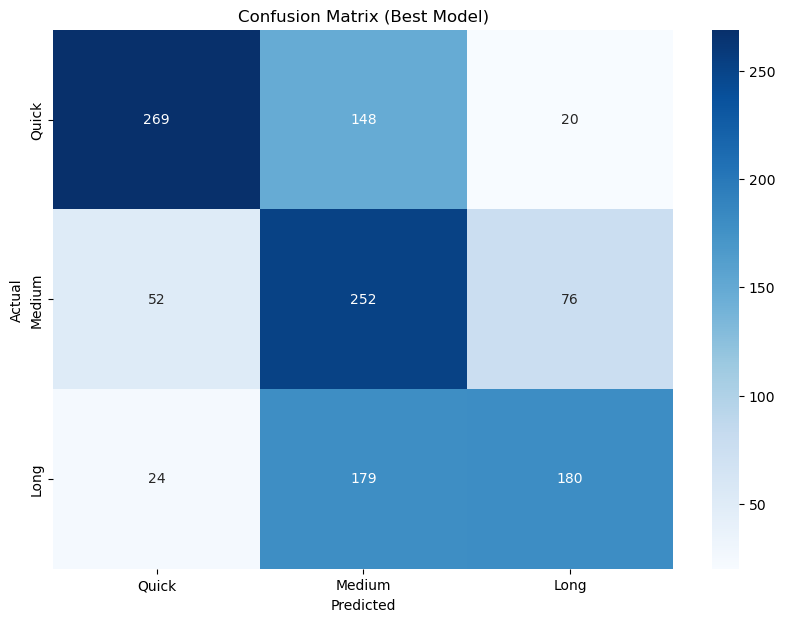


Feature Importance:
         feature  importance
0        n_steps    0.715896
1  n_ingredients    0.152702
6        protein    0.084079
4          sugar    0.030932
5         sodium    0.010298
8  carbohydrates    0.006093
2       calories    0.000000
3      total_fat    0.000000
7  saturated_fat    0.000000


In [46]:
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.metrics import accuracy_score, classification_report

# First, let's create categories for cooking time
def categorize_time(minutes):
    if minutes <= 15:
        return 0  # quick
    elif minutes <= 30:
        return 1  # medium
    else:
        return 2  # long

# Create balanced sample for each time category
merged_df2['time_category'] = merged_df2['minutes'].apply(categorize_time)

# Sample equal amounts from each category
quick = merged_df2[merged_df2['time_category'] == 0].sample(n=2000, random_state=42)
medium = merged_df2[merged_df2['time_category'] == 1].sample(n=2000, random_state=42)
long = merged_df2[merged_df2['time_category'] == 2].sample(n=2000, random_state=42)

# Combine the balanced samples
balanced_df = pd.concat([quick, medium, long])

# Extract nutrition values
#balanced_df['nutrition'] = balanced_df['nutrition'].apply(eval)  # Convert string to list
balanced_df['calories'] = balanced_df['nutrition'].apply(lambda x: x[0])
balanced_df['total_fat'] = balanced_df['nutrition'].apply(lambda x: x[1])
balanced_df['sugar'] = balanced_df['nutrition'].apply(lambda x: x[2])
balanced_df['sodium'] = balanced_df['nutrition'].apply(lambda x: x[3])
balanced_df['protein'] = balanced_df['nutrition'].apply(lambda x: x[4])
balanced_df['saturated_fat'] = balanced_df['nutrition'].apply(lambda x: x[5])
balanced_df['carbohydrates'] = balanced_df['nutrition'].apply(lambda x: x[6])

# Prepare features and target
features = [
    'n_steps',
    'n_ingredients',
    'calories',
    'total_fat',
    'sugar',
    'sodium',
    'protein',
    'saturated_fat',
    'carbohydrates'
]

X = balanced_df[features]
y = balanced_df['time_category']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define hyperparameters
hyperparameters = {
    'classifier__max_depth': [2, 3, 4, 5, 6, 7, None],
    'classifier__min_samples_split': [2, 3, 5, 8, 10],
    'classifier__criterion': ['gini', 'entropy']
}

# Create pipeline
pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('poly', PolynomialFeatures(4)),
    ('classifier', DecisionTreeClassifier())
])

# Perform grid search
searcher = GridSearchCV(
    estimator=pipeline,
    param_grid=hyperparameters,
    scoring='accuracy',
    cv=3,
    n_jobs=-1,
    verbose=1
)

# Fit the model
searcher.fit(X_train, y_train)

# Print best parameters
print("Best parameters:", searcher.best_params_)

# Extract best parameters
best_param = searcher.best_params_
params = pd.Series(list(best_param.keys())).apply(lambda x: x.split('__')[1])
best = {}
for n in range(len(params)):
    best[params[n]] = list(best_param.values())[n]

# Train final model with best parameters
final_tree = DecisionTreeClassifier(**best, random_state=42)
final_tree.fit(X_train, y_train)

# Evaluate model
test_accuracy = final_tree.score(X_test, y_test)
print("\nTest Accuracy:", test_accuracy)

# Make predictions
time_predict = final_tree.predict(X_test)

# Print classification report
print("\nClassification Report:")
print(classification_report(y_test, time_predict,
                          target_names=['Quick (≤15min)', 'Medium (16-30min)', 'Long (>30min)']))

# Create confusion matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, time_predict)
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Quick', 'Medium', 'Long'],
            yticklabels=['Quick', 'Medium', 'Long'])
plt.title('Confusion Matrix (Best Model)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Feature importance
feature_importance = pd.DataFrame({
    'feature': features,
    'importance': final_tree.feature_importances_
})

print("\nFeature Importance:")
print(feature_importance.sort_values('importance', ascending=False))

## Step 8: Fairness Analysis

In [47]:
from sklearn.metrics import accuracy_score
import numpy as np

# Get predictions first
test_predictions = searcher.predict(X_test)

# Define groups based on sugar content
def get_sugar_level(sugar):
    return 'low_sugar' if sugar <= X_test['sugar'].median() else 'high_sugar'

# Add sugar level labels
sugar_labels = X_test['sugar'].apply(get_sugar_level)

# Calculate accuracy for each group
low_sugar_mask = sugar_labels == 'low_sugar'
high_sugar_mask = sugar_labels == 'high_sugar'

low_sugar_accuracy = accuracy_score(y_test[low_sugar_mask], test_predictions[low_sugar_mask])
high_sugar_accuracy = accuracy_score(y_test[high_sugar_mask], test_predictions[high_sugar_mask])

# Calculate observed difference
observed_diff = low_sugar_accuracy - high_sugar_accuracy

# Permutation test
n_permutations = 1000
diff_array = np.zeros(n_permutations)

for i in range(n_permutations):
    # Shuffle the sugar labels
    shuffled_labels = np.random.permutation(sugar_labels.values)
    
    # Calculate accuracies with shuffled labels
    low_sugar_mask_perm = shuffled_labels == 'low_sugar'
    high_sugar_mask_perm = shuffled_labels == 'high_sugar'
    
    low_sugar_acc_perm = accuracy_score(y_test[low_sugar_mask_perm], test_predictions[low_sugar_mask_perm])
    high_sugar_acc_perm = accuracy_score(y_test[high_sugar_mask_perm], test_predictions[high_sugar_mask_perm])
    
    diff_array[i] = low_sugar_acc_perm - high_sugar_acc_perm

# Calculate p-value
p_value = np.mean(np.abs(diff_array) >= np.abs(observed_diff))

print("Fairness Analysis Results:")
print(f"Low Sugar Recipes Accuracy: {low_sugar_accuracy:.4f}")
print(f"High Sugar Recipes Accuracy: {high_sugar_accuracy:.4f}")
print(f"Observed Difference: {observed_diff:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("The model shows significant performance differences between low and high sugar recipes")
else:
    print("No significant evidence of unfair performance between low and high sugar recipes")

# Print group sizes
print("\nGroup Sizes:")
print(f"Low Sugar Recipes: {sum(low_sugar_mask)}")
print(f"High Sugar Recipes: {sum(high_sugar_mask)}")

import plotly.graph_objects as go
import numpy as np

# Create histogram of permuted differences
fig = go.Figure()

# Add histogram of permuted differences
fig.add_trace(go.Histogram(
    x=diff_array,
    name='Permuted Differences',
    nbinsx=30,
    opacity=0.7
))

# Add vertical line for observed difference
fig.add_vline(
    x=observed_diff,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Observed Difference: {observed_diff:.4f}",
    annotation_position="top"
)

# Update layout
fig.update_layout(
    title='Permutation Test Results: Model Fairness Analysis<br>(Low Sugar vs High Sugar Recipes)',
    xaxis_title="Accuracy Difference (Low Sugar - High Sugar)",
    yaxis_title="Frequency",
    showlegend=True,
    width=900,
    height=500
)

# Add p-value annotation
fig.add_annotation(
    text=f"p-value: {p_value:.4f}",
    xref="paper", yref="paper",
    x=0.98, y=0.95,
    showarrow=False,
    bgcolor="white",
    bordercolor="black",
    borderwidth=1
)

fig.show()
fig.write_html('assets/perm3_part8.html', include_plotlyjs='cdn')

Fairness Analysis Results:
Low Sugar Recipes Accuracy: 0.5605
High Sugar Recipes Accuracy: 0.5980
Observed Difference: -0.0375
P-value: 0.1740
No significant evidence of unfair performance between low and high sugar recipes

Group Sizes:
Low Sugar Recipes: 603
High Sugar Recipes: 597
